In [6]:
using SBMLToolkit, ModelingToolkit, DifferentialEquations, StochasticDiffEq
using Plots
using DataFrames
using CSV
using Random
using Distributions
using SBML
using SymbolicUtils
using StaticArrays
using Catalyst
using AdvancedMH
using MCMCChains
using MCMCChainsStorage
using AbstractMCMC
using StatsPlots
using ArviZ
using HDF5

using Particles
using ParticlesDE
using StaticDistributions

include("plot_functions.jl")
include("utilities.jl")
include("sir_model.jl");

## SIR-model filter
In this notebook I try the full PMMH algorithm for the simple SIR-model and investigate the results.

### Adaptive solver
In order not to worry too much about the proposal covariance, I will use the adaptve MH-algorithm from pypesto.

In [6]:
# interface PyPesto
using PyCall
pypesto = pyimport("pypesto");

In [7]:
# hyperparameter settings
nchains = 3
niter = 100
nparticles = 100

# for pypesto we need the negative log-likelihood

llh=likelihood(nparticles)
neg_llh = let llh = llh
    p -> begin
        return -llh(p)
    end
end

# transform to pypesto objective
objective = pypesto.Objective(fun=neg_llh)

# create pypesto problem

pypesto_problem = pypesto.Problem(
    objective,
    x_names=["beta", "gamma"],
    lb=[0.001, 0.001], # parameter bounds
    ub=[1, 1], # NB for sampling it is usually better if you remap parameters to (-∞, ∞)
    copy_objective=false, # important
)

PyObject <pypesto.problem.base.Problem object at 0x00000000F0F69BA0>

In [ ]:
# specify sampler
sampler = pypesto.sample.AdaptiveMetropolisSampler()

# get initial parameters
init_par = rand(prior_dist)

# sample
chains_list = []

for i in 1:nchains
    result = pypesto.sample.sample(
        pypesto_problem,
        n_samples=niter,
        x0=Vector(init_par), # starting point
        sampler=sampler,
    )
    pypesto.sample.diagnostics.geweke_test(result)
    # convert to Chains object
    push!(chains_list, Chains_from_pypesto(result))
end

all_chains = chains_list[1].value.data

if (nchains > 1)
    for i in 2:nchains
        all_chains = cat(all_chains, chains_list[i].value.data, dims=(3,3))
    end
end

chs = MCMCChains.Chains(all_chains, [:beta, :gamma, :lp])
chain = set_section(chs, Dict(:parameters => [:beta, :gamma], :internals => [:lp]));

In [187]:
evaluate_chain(problem, chain, tobs, y_load, ["beta", "gamma"];burn_in=20)

Geweke test indicates no convergence of the chain

## Results

For 60 particles burn-ins are 10000, 60000, 20000, not converged.\
For 80 particles burn-ins are 30000, 10000, 30000, not converged.\
For 100 particles burn-ins are 40000, 20000, 30000, 50000.
For 500 particles burn-ins are 10000, 90000, not converged, 30000.

247.62099838037918Burn In: 50000
 Abs. err. between post. mean and true values:[-0.02094552259529517, -0.0008557146461644002]4×2 DataFrame
 Row │ MSJD      acceptance_rate 
     │ Float64   Any             
─────┼───────────────────────────
   1 │ 0.387315  0.7664
   2 │ 0.367148  0.76766
   3 │ 0.373965  0.76616
   4 │ 0.369535  0.7659
2×8 DataFrame
 Row │ parameters  mean       std         naive_se    mcse         ess      rhat     ess_per_sec 
     │ Symbol      Float64    Float64     Float64     Float64      Float64  Float64  Float64     
─────┼───────────────────────────────────────────────────────────────────────────────────────────
   1 │ beta        0.220946   0.0245837   5.49696e-5  0.000184296  17772.7  1.00037      1.19623
   2 │ gamma       0.0508557  0.00542616  1.2133e-5   3.88907e-5   17712.3  1.00022      1.19217

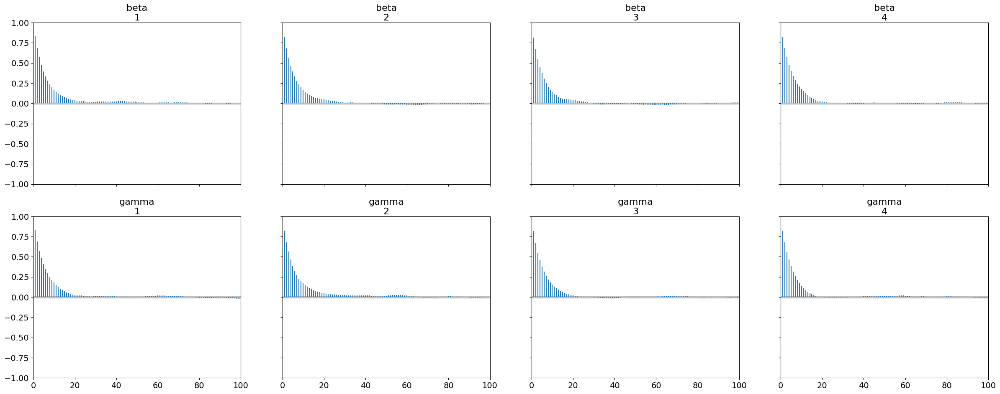

In [55]:
chain = h5open("./output/paralell_sir_4chs_100000it_100p.h5", "r") do f
   read(f, Chains)
end
time = open("./output/time_parallel_sir_4chs_100000it_100p.txt", "r") do f
    read(f, Float64)
end
print(time/60)
chain = setinfo(chain, (start_time=0.0, stop_time=time));
evaluate_chain(problem, chain, tobs, y_load, ["beta", "gamma"])

In [ ]:
chain = h5open("./output/paralell_sir_4chs_100000it_80p.h5", "r") do f
   read(f, Chains)
end
time = open("./output/time_parallel_sir_4chs_100000it_80p.txt", "r") do f
    read(f, Float64)
end
print(time/60)
chain = setinfo(chain, (start_time=0.0, stop_time=time))
evaluate_chain(problem, chain[:,:,1:3], tobs, y_load, ["beta", "gamma"])

In [ ]:
chain = h5open("./output/paralell_sir_4chs_100000it_60p.h5", "r") do f
   read(f, Chains)
end
time = open("./output/time_parallel_sir_4chs_100000it_60p.txt", "r") do f
    read(f, Float64)
end
print(time/60)
chain = setinfo(chain, (start_time=0.0, stop_time=time))
evaluate_chain(problem, chain[:,:,1:3], tobs, y_load, ["beta", "gamma"])